## Load Google Colab

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Load Import Modules

In [2]:
import numpy as np
import json
import os, sys
from PIL import Image
from tqdm import tqdm
import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torch.utils.data import DataLoader, Dataset
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import albumentations as A
from albumentations.pytorch import ToTensorV2
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import cv2
import pickle
import zipfile

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.2 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


## Load 'best_model.pth'

In [4]:
# Get device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

print(device)

# Get checkpoint
checkpoint_path = '/content/drive/My Drive/IDRT_MODEL/IDRT/building_detection/best_model.pth'
checkpoint = torch.load(checkpoint_path, map_location=device)

# Fine-tuned Model
model_ft = fasterrcnn_resnet50_fpn(pretrained=True)
in_features = model_ft.roi_heads.box_predictor.cls_score.in_features
model_ft.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=2)

# Load trained weights
model_ft.load_state_dict(checkpoint['model_state_dict'])

# Load to device
model_ft.to(device)

cpu


<ipython-input-4-cb1ed8cb6909>:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, map_location=device)
/usr/local/lib/python3.11/dist-

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

## Dataloader Functions

In [ ]:
class InferenceDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_files = [f for f in os.listdir(root_dir) if f.endswith('.jpg') or f.endswith('.png')]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_file = self.image_files[idx]
        image_path = os.path.join(self.root_dir, image_file)
        try:
            # Load image
            image = Image.open(image_path).convert("RGB")
            # Apply transformations
            if self.transform:
                image = self.transform(image=np.array(image))['image']
            return image, image_file
        except Exception as e:
            # Handle the exception (e.g. log it) and return None
            print(f"Error loading image {image_file}: {e}")
            pass
            # return None  # Indicate that this sample should be skipped

In [ ]:
def get_inference_transform():
    return A.Compose([
        A.Resize(512, 512),  # Resize to match training dimensions
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2()
    ])

def collate_fn(batch):
    images, image_files = zip(*batch)
    images = list(images)
    image_files = list(image_files)
    return images, image_files

# noaa_dir = '/scratch/user/junhokim/data/Inference_Input/street_view_images_ms_final_fov'
# noaa_bbox_dir = '/scratch/user/junhokim/data/Inference_Output/street_view_images_ms_final_fov_buildings'
# os.makedirs(noaa_bbox_dir, exist_ok=True)

# inference_dataset = InferenceDataset(root_dir=noaa_dir, transform=get_inference_transform())
# inference_loader = DataLoader(inference_dataset, batch_size=4, shuffle=False, collate_fn=collate_fn)

## Load Dataset

In [ ]:
gsv_path = '/content/drive/My Drive/IDRT_MODEL/IDRT/GSV_final.zip'

In [ ]:
# Define the extraction directory
gsv_data_dir = '/content/gsv_original_images'
gsv_data_buildings = '/content/gsv_buildings'
os.makedirs(gsv_data_buildings, exist_ok=True)

# Unzip the file
with zipfile.ZipFile(gsv_path, 'r') as zip_ref:
    zip_ref.extractall(gsv_data_dir)
print(f'Files extracted to: {gsv_data_dir}')

In [ ]:
for root, dirs, files in os.walk(noaa_data_dir):
    pass
print(f'Total files: {len(files)}') # 81

In [ ]:
valid_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.gif')

# Function to clean up non-image files
def remove_non_image_files(directory):
    removed_files = 0
    for root, dirs, files in os.walk(directory):
        for file in files:
            if not file.lower().endswith(valid_extensions):  # Check if the file is not an image
                file_path = os.path.join(root, file)
                os.remove(file_path)  # Delete the file
                removed_files += 1
    print(f'{removed_files} non-image files removed from {directory}')

# Remove non-image files from both directories
remove_non_image_files(noaa_data_dir)

# Count remaining files
for root, dirs, files in os.walk(noaa_data_dir):
    pass
print(f'Total image files in {noaa_data_dir}: {len(files)}')

In [ ]:
gsv_final_dir = '/content/gsv_original_images/GSV_final/'

In [ ]:
inference_dataset = InferenceDataset(root_dir=gsv_final_dir, transform=get_inference_transform())
inference_loader = DataLoader(inference_dataset, batch_size=4, shuffle=False, collate_fn=collate_fn)

## Run Inference

In [ ]:
def run_inference(model, data_loader, device, num_images_to_visualize=30):
    model.eval()
    model.to(device)
    predictions = []
    images_to_visualize = []
    image_files_to_visualize = []
    images_collected = 0

    with torch.no_grad():
        # Add tqdm progress bar here
        for images, image_files in tqdm(data_loader, desc="Running Inference"):
            images = [img.to(device) for img in images]
            outputs = model(images)

            for i in range(len(images)):
                # Collect images and filenames for visualization
                if images_collected < num_images_to_visualize:
                    img = images[i].cpu().permute(1, 2, 0).numpy()
                    # Unnormalize
                    img = img * np.array([0.229, 0.224, 0.225]) + \
                          np.array([0.485, 0.456, 0.406])
                    img = np.clip(img, 0, 1)
                    images_to_visualize.append(img)
                    image_files_to_visualize.append(image_files[i])
                    images_collected += 1

                # Collect predictions
                boxes = outputs[i]['boxes'].cpu().numpy()
                labels = outputs[i]['labels'].cpu().numpy()
                scores = outputs[i]['scores'].cpu().numpy()
                prediction = {
                    'image_file': image_files[i],
                    'boxes': boxes.tolist(),
                    'labels': labels.tolist(),
                    'scores': scores.tolist()
                }
                predictions.append(prediction)

    return images_to_visualize, image_files_to_visualize, predictions

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
images_to_visualize, image_files_to_visualize, predictions = run_inference(model_ft,
                                                                           inference_loader,
                                                                           device,
                                                                           num_images_to_visualize=100)

Running Inference: 100%|██████████| 1620/1620 [02:16<00:00, 11.88it/s]


## Sanity Check

In [ ]:
print(predictions[0])
print(image_files_to_visualize[0])
# assert len(predictions) == len(image_files_to_visualize)

print(len(predictions))
# print(len(image_files_to_visualize))
# print(len(images_to_visualize))

{'image_file': '35.19336219253202_-97.45160279385236_fov_75.jpg', 'boxes': [[1.4212108850479126, 178.2149200439453, 431.4259338378906, 340.13140869140625], [0.9632909893989563, 189.3714141845703, 154.41632080078125, 345.5182800292969], [422.42291259765625, 209.60018920898438, 511.6872863769531, 299.05792236328125], [180.71685791015625, 186.67628479003906, 496.7577209472656, 331.5647277832031], [417.25775146484375, 94.98611450195312, 512.0, 310.9400634765625]], 'labels': [1, 1, 1, 1, 1], 'scores': [0.9903268218040466, 0.7824006080627441, 0.35016804933547974, 0.07395123690366745, 0.05206991732120514]}
35.19336219253202_-97.45160279385236_fov_75.jpg
6478


## Visualize

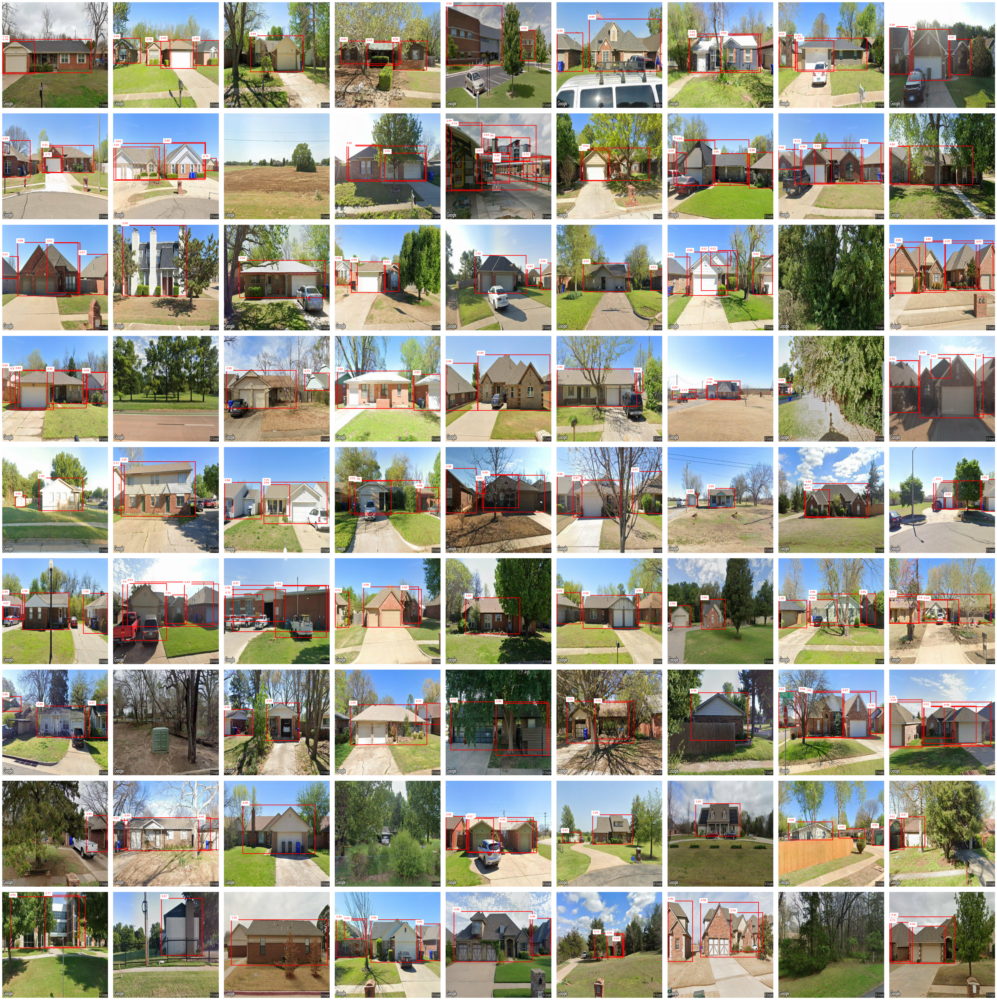

In [ ]:
import matplotlib.patches as patches

def visualize_predictions_grid(images, predictions, num_rows, num_cols, confidence_threshold):
    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(num_cols*5, num_rows*5))
    axes = axes.flatten()

    for idx, ax in enumerate(axes):
        if idx >= len(images):
            ax.axis('off')
            continue

        img = images[idx]
        prediction = predictions[idx]
        boxes = np.array(prediction['boxes'])
        scores = np.array(prediction['scores'])

        ax.imshow(img)
        ax.axis('off')

        # Draw predicted boxes
        for i, box in enumerate(boxes):
            score = scores[i]
            if score >= confidence_threshold:  # Adjust threshold as needed
                x_min, y_min, x_max, y_max = box
                rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                                         linewidth=2, edgecolor='r', facecolor='none')
                ax.add_patch(rect)
                # Optionally display score
                ax.text(x_min, y_min - 5, f'{score:.2f}', color='red', fontsize=8, backgroundcolor='white')
    plt.tight_layout()
    plt.show()

# Set the grid to 9x9
num_rows, num_cols = 9, 9
confidence_threshold = 0.5

# Call the function with the updated grid size
visualize_predictions_grid(images_to_visualize, predictions[:81], num_rows, num_cols, confidence_threshold)

## Save Inference Outputs

In [ ]:
def run_inference_and_save_results(model, data_loader, device, noaa_bbox_dir, score_threshold):
    model.eval()
    model.to(device)
    os.makedirs(noaa_bbox_dir, exist_ok=True)

    # Counters for the different types of images
    no_bbox_count = 0
    valid_bbox_count = 0
    invalid_bbox_count = 0

    with torch.no_grad():
        for images, image_files in tqdm(data_loader):
            images = [img.to(device) for img in images]
            outputs = model(images)

            for i in range(len(images)):
                image_file = image_files[i]
                img = images[i].cpu().permute(1, 2, 0).numpy()

                # Unnormalize the image
                img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
                img = np.clip(img, 0, 1)

                # Convert image from RGB to BGR for OpenCV
                img_uint8 = (img * 255).astype(np.uint8)
                img_bgr = cv2.cvtColor(img_uint8, cv2.COLOR_RGB2BGR)

                # Get predictions
                boxes = outputs[i]['boxes'].cpu().numpy()
                scores = outputs[i]['scores'].cpu().numpy()

                # Filter boxes by threshold
                valid_indices = [idx for idx, s in enumerate(scores) if s >= score_threshold]

                if len(valid_indices) == 0:
                    # No bounding box found above the threshold
                    # print(f"No bounding box detected for {image_file}. No bounding box.")
                    save_path = os.path.join(noaa_bbox_dir, image_file)
                    cv2.imwrite(save_path, img_bgr)
                    no_bbox_count += 1
                else:
                    # Among the valid boxes, choose the one with the highest score
                    best_idx = valid_indices[np.argmax(scores[valid_indices])]

                    x1, y1, x2, y2 = boxes[best_idx]
                    height, width, _ = img_bgr.shape
                    # Adjust coordinates
                    x1 = int(max(0, min(width - 1, x1)))
                    y1 = int(max(0, min(height - 1, y1)))
                    x2 = int(max(0, min(width - 1, x2)))
                    y2 = int(max(0, min(height - 1, y2)))

                    cropped_img = img_bgr[y1:y2, x1:x2]
                    if cropped_img.size > 0:
                        # Save the cropped bounding box image with the same filename as the original
                        bbox_img_path = os.path.join(noaa_bbox_dir, image_file)
                        cv2.imwrite(bbox_img_path, cropped_img)
                        valid_bbox_count += 1
                    else:
                        # If the cropped image is somehow invalid, save the original image and print a warning
                        # print(f"Invalid cropped area for {image_file}. Invalid.")
                        save_path = os.path.join(noaa_bbox_dir, image_file)
                        cv2.imwrite(save_path, img_bgr)
                        invalid_bbox_count += 1

    # Print the total counts
    total_count = no_bbox_count + valid_bbox_count + invalid_bbox_count
    print("\nSummary:")
    print(f"Images with no bounding boxes: {no_bbox_count}")
    print(f"Images with valid bounding boxes: {valid_bbox_count}")
    print(f"Images with invalid cropped areas: {invalid_bbox_count}")
    print(f"Total Number of Images: {total_count}")

In [ ]:
score_threshold = 0.5
run_inference_and_save_results(model_ft, inference_loader, device, noaa_bbox_dir, score_threshold)

Running Inference:   0%|          | 4/1620 [00:00<04:22,  6.15it/s]

No bounding box detected for 35.130282434852745_-97.47883999559453_fov_75.jpg. Saving original image.


Running Inference:   0%|          | 7/1620 [00:01<04:42,  5.72it/s]

No bounding box detected for 35.16110179896802_-97.4728098258211_fov_75.jpg. Saving original image.
No bounding box detected for 35.17575771702027_-97.41990928098103_fov_75.jpg. Saving original image.


Running Inference:   1%|          | 15/1620 [00:02<03:49,  6.98it/s]

No bounding box detected for 35.1824280071836_-97.42924421152085_fov_75.jpg. Saving original image.


Running Inference:   1%|          | 18/1620 [00:02<03:53,  6.85it/s]

No bounding box detected for 35.15942545002511_-97.40976467854011_fov_75.jpg. Saving original image.


Running Inference:   1%|▏         | 21/1620 [00:03<04:01,  6.63it/s]

No bounding box detected for 35.210518204311_-97.34636258913604_fov_75.jpg. Saving original image.
No bounding box detected for 35.16118118814694_-97.47320998934761_fov_75.jpg. Saving original image.


Running Inference:   2%|▏         | 28/1620 [00:04<03:52,  6.84it/s]

No bounding box detected for 35.209708432048764_-97.32453029636352_fov_75.jpg. Saving original image.


Running Inference:   3%|▎         | 46/1620 [00:07<03:52,  6.77it/s]

No bounding box detected for 35.12995319745772_-97.49411498975151_fov_75.jpg. Saving original image.


Running Inference:   4%|▍         | 63/1620 [00:09<03:46,  6.86it/s]

No bounding box detected for 35.20449442181514_-97.34930972032139_fov_75.jpg. Saving original image.


Running Inference:   4%|▍         | 68/1620 [00:10<03:34,  7.23it/s]

No bounding box detected for 35.18014539660912_-97.45479256769582_fov_75.jpg. Saving original image.


Running Inference:   4%|▍         | 70/1620 [00:10<03:42,  6.95it/s]

No bounding box detected for 35.21054657915032_-97.32538038751659_fov_75.jpg. Saving original image.
No bounding box detected for 35.21354240164027_-97.4172807206282_fov_75.jpg. Saving original image.


Running Inference:   5%|▍         | 75/1620 [00:12<11:52,  2.17it/s]

No bounding box detected for 35.12130700937242_-97.47593542402069_fov_75.jpg. Saving original image.


Running Inference:   5%|▍         | 79/1620 [00:13<06:46,  3.79it/s]

No bounding box detected for 35.150220234210295_-97.49206290426781_fov_75.jpg. Saving original image.


Running Inference:   5%|▌         | 84/1620 [00:14<05:29,  4.66it/s]

No bounding box detected for 35.189180982101256_-97.45528429521588_fov_75.jpg. Saving original image.


Running Inference:   5%|▌         | 85/1620 [00:14<05:31,  4.63it/s]

No bounding box detected for 35.15874921567738_-97.41431061823766_fov_75.jpg. Saving original image.


Running Inference:   6%|▌         | 96/1620 [00:16<04:05,  6.21it/s]

No bounding box detected for 35.192227597138434_-97.4181165824671_fov_75.jpg. Saving original image.


Running Inference:   7%|▋         | 114/1620 [00:19<03:26,  7.29it/s]

No bounding box detected for 35.18998599621745_-97.35501258507111_fov_75.jpg. Saving original image.


Running Inference:   7%|▋         | 116/1620 [00:19<03:28,  7.22it/s]

No bounding box detected for 35.20747879516506_-97.3284062008544_fov_75.jpg. Saving original image.


Running Inference:   8%|▊         | 122/1620 [00:20<03:24,  7.31it/s]

No bounding box detected for 35.20930342020102_-97.40855741189945_fov_75.jpg. Saving original image.
No bounding box detected for 35.20906159150376_-97.41814220241903_fov_75.jpg. Saving original image.


Running Inference:   8%|▊         | 124/1620 [00:20<03:25,  7.28it/s]

No bounding box detected for 35.16277871401781_-97.40566071726734_fov_75.jpg. Saving original image.
No bounding box detected for 35.184354271124434_-97.45512944899374_fov_75.jpg. Saving original image.


Running Inference:   8%|▊         | 126/1620 [00:21<03:30,  7.10it/s]

No bounding box detected for 35.16137361660397_-97.47531396950714_fov_75.jpg. Saving original image.


Running Inference:   8%|▊         | 129/1620 [00:21<05:01,  4.94it/s]

No bounding box detected for 35.1030167246525_-97.53932229319983_fov_75.jpg. Saving original image.


Running Inference:   9%|▊         | 140/1620 [00:23<03:53,  6.34it/s]

Running Inference:   9%|▉         | 149/1620 [00:25<03:59,  6.15it/s]

No bounding box detected for 35.213655006413134_-97.32853533667087_fov_75.jpg. Saving original image.
No bounding box detected for 35.203538368287056_-97.41164001672948_fov_75.jpg. Saving original image.
No bounding box detected for 35.19188627680491_-97.37245728106717_fov_75.jpg. Saving original image.


Running Inference:   9%|▉         | 151/1620 [00:25<03:43,  6.57it/s]

No bounding box detected for 35.191557857261294_-97.35443413419354_fov_75.jpg. Saving original image.


Running Inference:   9%|▉         | 153/1620 [00:26<03:43,  6.56it/s]

No bounding box detected for 35.21154620965132_-97.36004878181575_fov_75.jpg. Saving original image.
No bounding box detected for 35.20332881014006_-97.36859809410711_fov_75.jpg. Saving original image.


Running Inference:  10%|▉         | 157/1620 [00:26<03:27,  7.06it/s]

No bounding box detected for 35.13727422263288_-97.4776232326754_fov_75.jpg. Saving original image.


Running Inference:  10%|▉         | 158/1620 [00:26<03:25,  7.11it/s]

No bounding box detected for 35.20328862433386_-97.36322479346903_fov_75.jpg. Saving original image.
No bounding box detected for 35.174024279781285_-97.4455249979692_fov_75.jpg. Saving original image.
No bounding box detected for 35.21052458974522_-97.3235210006426_fov_75.jpg. Saving original image.


Running Inference:  10%|▉         | 161/1620 [00:27<03:49,  6.36it/s]

No bounding box detected for 35.2083855485779_-97.32404100269456_fov_75.jpg. Saving original image.


Running Inference:  10%|█         | 165/1620 [00:28<04:01,  6.02it/s]

No bounding box detected for 35.161820396588936_-97.47652443138615_fov_75.jpg. Saving original image.
No bounding box detected for 35.20339881592842_-97.34256700943128_fov_75.jpg. Saving original image.
No bounding box detected for 35.151383571940876_-97.49177014046492_fov_75.jpg. Saving original image.


Running Inference:  11%|█         | 173/1620 [00:30<04:43,  5.10it/s]

No bounding box detected for 35.20567340403428_-97.34990180762502_fov_75.jpg. Saving original image.


Running Inference:  11%|█         | 177/1620 [00:31<03:44,  6.42it/s]

No bounding box detected for 35.191172660637044_-97.35535300236097_fov_75.jpg. Saving original image.
No bounding box detected for 35.20005061375958_-97.34471961056009_fov_75.jpg. Saving original image.


Running Inference:  11%|█▏        | 186/1620 [00:32<03:31,  6.77it/s]

No bounding box detected for 35.1842893909587_-97.42324558544702_fov_75.jpg. Saving original image.
No bounding box detected for 35.16318472575904_-97.47525526845324_fov_75.jpg. Saving original image.


Running Inference:  13%|█▎        | 203/1620 [00:34<03:19,  7.11it/s]

No bounding box detected for 35.20311702399246_-97.41463162222128_fov_75.jpg. Saving original image.


Running Inference:  13%|█▎        | 207/1620 [00:35<03:31,  6.69it/s]

No bounding box detected for 35.14353398922008_-97.49328602440738_fov_75.jpg. Saving original image.
No bounding box detected for 35.214872590949625_-97.36129681123994_fov_75.jpg. Saving original image.
No bounding box detected for 35.162922864148015_-97.47611745862984_fov_75.jpg. Saving original image.


Running Inference:  13%|█▎        | 218/1620 [00:37<03:20,  6.99it/s]

No bounding box detected for 35.16133401756704_-97.47489159962686_fov_75.jpg. Saving original image.


Running Inference:  14%|█▎        | 221/1620 [00:37<03:23,  6.87it/s]

No bounding box detected for 35.21117367242922_-97.35821578345225_fov_75.jpg. Saving original image.


Running Inference:  14%|█▍        | 233/1620 [00:39<03:09,  7.33it/s]

No bounding box detected for 35.16171501031626_-97.47654516450297_fov_75.jpg. Saving original image.


Running Inference:  15%|█▍        | 238/1620 [00:39<03:15,  7.08it/s]

No bounding box detected for 35.17112343208054_-97.42856629404181_fov_75.jpg. Saving original image.


Running Inference:  15%|█▍        | 241/1620 [00:40<03:09,  7.29it/s]

No bounding box detected for 35.16075420431535_-97.47446741514969_fov_75.jpg. Saving original image.


Running Inference:  15%|█▌        | 243/1620 [00:40<03:11,  7.20it/s]

No bounding box detected for 35.179310804229395_-97.41053758624653_fov_75.jpg. Saving original image.


Running Inference:  15%|█▌        | 244/1620 [00:40<03:13,  7.11it/s]

No bounding box detected for 35.210295130878485_-97.34956355855456_fov_75.jpg. Saving original image.


Running Inference:  15%|█▌        | 251/1620 [00:41<03:13,  7.09it/s]

No bounding box detected for 35.1478190105215_-97.4673402894833_fov_75.jpg. Saving original image.
No bounding box detected for 35.120807462818824_-97.47557664288496_fov_75.jpg. Saving original image.


Running Inference:  16%|█▌        | 254/1620 [00:42<03:10,  7.16it/s]

No bounding box detected for 35.215612172740435_-97.35389402854544_fov_75.jpg. Saving original image.


Running Inference:  16%|█▌        | 263/1620 [00:43<03:12,  7.07it/s]

No bounding box detected for 35.19131477246348_-97.35677857881048_fov_75.jpg. Saving original image.


Running Inference:  17%|█▋        | 273/1620 [00:44<03:25,  6.54it/s]

No bounding box detected for 35.209123186417415_-97.32827741837527_fov_75.jpg. Saving original image.


Running Inference:  17%|█▋        | 279/1620 [00:45<03:17,  6.79it/s]

No bounding box detected for 35.2154767951355_-97.35880141714479_fov_75.jpg. Saving original image.


Running Inference:  17%|█▋        | 283/1620 [00:46<04:07,  5.41it/s]

No bounding box detected for 35.21353421933106_-97.33246859816487_fov_75.jpg. Saving original image.
No bounding box detected for 35.20565027454831_-97.34633485942653_fov_75.jpg. Saving original image.


Running Inference:  18%|█▊        | 292/1620 [00:47<03:06,  7.12it/s]

No bounding box detected for 35.16091339449302_-97.47441660643723_fov_75.jpg. Saving original image.
No bounding box detected for 35.16122861601014_-97.47438342267064_fov_75.jpg. Saving original image.


Running Inference:  18%|█▊        | 299/1620 [00:48<03:20,  6.59it/s]

No bounding box detected for 35.18921987114059_-97.41707930550841_fov_75.jpg. Saving original image.


Running Inference:  19%|█▊        | 302/1620 [00:49<03:16,  6.70it/s]

No bounding box detected for 35.16218800000969_-97.47606788445924_fov_75.jpg. Saving original image.


Running Inference:  19%|█▉        | 304/1620 [00:49<03:11,  6.87it/s]

No bounding box detected for 35.1615457897822_-97.47486820749687_fov_75.jpg. Saving original image.


Running Inference:  19%|█▉        | 310/1620 [00:52<06:56,  3.15it/s]

No bounding box detected for 35.16077140413353_-97.47497798162458_fov_75.jpg. Saving original image.


Running Inference:  19%|█▉        | 312/1620 [00:52<05:00,  4.35it/s]

No bounding box detected for 35.19807529671091_-97.40314942555827_fov_75.jpg. Saving original image.


Running Inference:  20%|██        | 328/1620 [00:54<02:57,  7.30it/s]

No bounding box detected for 35.16074959222688_-97.47543017557231_fov_75.jpg. Saving original image.


Running Inference:  20%|██        | 332/1620 [00:55<03:20,  6.42it/s]

No bounding box detected for 35.183210852406255_-97.45502114016995_fov_75.jpg. Saving original image.
No bounding box detected for 35.21425473128786_-97.33399809263379_fov_75.jpg. Saving original image.


Running Inference:  21%|██        | 340/1620 [00:57<03:43,  5.72it/s]

No bounding box detected for 35.211556117994164_-97.33025053994925_fov_75.jpg. Saving original image.


Running Inference:  21%|██▏       | 347/1620 [00:58<03:15,  6.50it/s]

No bounding box detected for 35.21508870684612_-97.3213821632834_fov_75.jpg. Saving original image.


Running Inference:  22%|██▏       | 349/1620 [00:58<03:19,  6.36it/s]

No bounding box detected for 35.2074490099662_-97.3446705943321_fov_75.jpg. Saving original image.
No bounding box detected for 35.20358800491532_-97.3962315508876_fov_75.jpg. Saving original image.


Running Inference:  22%|██▏       | 359/1620 [01:00<03:02,  6.93it/s]

No bounding box detected for 35.16557161493917_-97.41846593313504_fov_75.jpg. Saving original image.


Running Inference:  22%|██▏       | 362/1620 [01:00<03:02,  6.90it/s]

No bounding box detected for 35.20006589150144_-97.41146688542294_fov_75.jpg. Saving original image.


Running Inference:  22%|██▏       | 363/1620 [01:00<02:59,  6.99it/s]

No bounding box detected for 35.209782979891266_-97.3239712003304_fov_75.jpg. Saving original image.


Running Inference:  23%|██▎       | 368/1620 [01:01<03:18,  6.32it/s]

No bounding box detected for 35.14640661155646_-97.46881498182_fov_75.jpg. Saving original image.


Running Inference:  23%|██▎       | 380/1620 [01:03<02:57,  7.01it/s]

No bounding box detected for 35.20440196967212_-97.4014524207217_fov_75.jpg. Saving original image.


Running Inference:  24%|██▍       | 385/1620 [01:04<02:44,  7.49it/s]

No bounding box detected for 35.210490584375876_-97.35251313829076_fov_75.jpg. Saving original image.


Running Inference:  25%|██▍       | 397/1620 [01:05<03:03,  6.68it/s]

No bounding box detected for 35.21039221285996_-97.32444322109455_fov_75.jpg. Saving original image.


Running Inference:  25%|██▍       | 398/1620 [01:05<03:09,  6.44it/s]

No bounding box detected for 35.16073237766132_-97.47529359571652_fov_75.jpg. Saving original image.
No bounding box detected for 35.20570529326948_-97.37682201186975_fov_75.jpg. Saving original image.


Running Inference:  25%|██▍       | 402/1620 [01:06<03:05,  6.57it/s]

No bounding box detected for 35.20484383019068_-97.42773800628402_fov_75.jpg. Saving original image.
No bounding box detected for 35.16023462351172_-97.477276968066_fov_75.jpg. Saving original image.


Running Inference:  25%|██▌       | 406/1620 [01:07<02:54,  6.95it/s]

No bounding box detected for 35.169061565848516_-97.41061328342559_fov_75.jpg. Saving original image.
No bounding box detected for 35.197886013120595_-97.41140799985793_fov_75.jpg. Saving original image.


Running Inference:  25%|██▌       | 410/1620 [01:07<03:02,  6.64it/s]

No bounding box detected for 35.214305210587504_-97.35588561149669_fov_75.jpg. Saving original image.


Running Inference:  26%|██▌       | 414/1620 [01:08<03:02,  6.59it/s]

No bounding box detected for 35.200559654940555_-97.41593411749935_fov_75.jpg. Saving original image.


Running Inference:  26%|██▌       | 416/1620 [01:08<02:55,  6.87it/s]

No bounding box detected for 35.17544111683752_-97.3851980045324_fov_75.jpg. Saving original image.


Running Inference:  26%|██▌       | 418/1620 [01:08<02:51,  7.00it/s]

No bounding box detected for 35.174332564973156_-97.426372441288_fov_75.jpg. Saving original image.
No bounding box detected for 35.20957319758842_-97.32642960180213_fov_75.jpg. Saving original image.


Running Inference:  26%|██▋       | 426/1620 [01:10<02:46,  7.17it/s]

No bounding box detected for 35.160145597919964_-97.40460259682742_fov_75.jpg. Saving original image.


Running Inference:  26%|██▋       | 429/1620 [01:10<02:46,  7.16it/s]

No bounding box detected for 35.15163606850468_-97.49220827962839_fov_75.jpg. Saving original image.


Running Inference:  27%|██▋       | 436/1620 [01:12<04:33,  4.32it/s]

No bounding box detected for 35.16106801635582_-97.47423442809759_fov_75.jpg. Saving original image.


Running Inference:  27%|██▋       | 440/1620 [01:13<03:07,  6.30it/s]

No bounding box detected for 35.20438379548002_-97.39969901708491_fov_75.jpg. Saving original image.


Running Inference:  28%|██▊       | 450/1620 [01:14<03:32,  5.52it/s]

No bounding box detected for 35.19232422249174_-97.35577858621373_fov_75.jpg. Saving original image.


Running Inference:  28%|██▊       | 458/1620 [01:16<02:46,  6.99it/s]

No bounding box detected for 35.21084399322578_-97.3212387947307_fov_75.jpg. Saving original image.


Running Inference:  29%|██▊       | 462/1620 [01:16<02:37,  7.35it/s]

No bounding box detected for 35.158352542835814_-97.41415844762105_fov_75.jpg. Saving original image.


Running Inference:  29%|██▊       | 464/1620 [01:16<02:39,  7.25it/s]

No bounding box detected for 35.212545622352884_-97.32141500825682_fov_75.jpg. Saving original image.
No bounding box detected for 35.2107417971511_-97.42324919667445_fov_75.jpg. Saving original image.


Running Inference:  29%|██▉       | 473/1620 [01:18<02:55,  6.53it/s]

No bounding box detected for 35.160772006367054_-97.47558761430896_fov_75.jpg. Saving original image.
No bounding box detected for 35.20584556093837_-97.33608056479216_fov_75.jpg. Saving original image.


Running Inference:  29%|██▉       | 477/1620 [01:18<02:51,  6.67it/s]

No bounding box detected for 35.16948360285338_-97.4267026080875_fov_75.jpg. Saving original image.


Running Inference:  30%|███       | 491/1620 [01:21<02:48,  6.71it/s]

No bounding box detected for 35.20696059929104_-97.33248861262936_fov_75.jpg. Saving original image.


Running Inference:  30%|███       | 494/1620 [01:21<02:35,  7.23it/s]

No bounding box detected for 35.18415680979244_-97.42277382619241_fov_75.jpg. Saving original image.


Running Inference:  31%|███       | 496/1620 [01:22<03:07,  5.99it/s]

No bounding box detected for 35.143814401107846_-97.48699061292987_fov_75.jpg. Saving original image.


Running Inference:  31%|███       | 499/1620 [01:22<02:53,  6.47it/s]

No bounding box detected for 35.18173142545101_-97.40803600404239_fov_75.jpg. Saving original image.


Running Inference:  31%|███       | 503/1620 [01:23<02:42,  6.85it/s]

No bounding box detected for 35.14641455270195_-97.49049601284285_fov_75.jpg. Saving original image.


Running Inference:  31%|███       | 505/1620 [01:23<02:35,  7.17it/s]

No bounding box detected for 35.2006453901349_-97.43888582946533_fov_75.jpg. Saving original image.


Running Inference:  32%|███▏      | 512/1620 [01:24<03:04,  5.99it/s]

No bounding box detected for 35.21496080801574_-97.33393339106712_fov_75.jpg. Saving original image.
No bounding box detected for 35.182656834358454_-97.42864117737054_fov_75.jpg. Saving original image.


Running Inference:  32%|███▏      | 517/1620 [01:25<02:55,  6.29it/s]

No bounding box detected for 35.145124864491876_-97.4971419888655_fov_75.jpg. Saving original image.
No bounding box detected for 35.21405780433474_-97.3612075905659_fov_75.jpg. Saving original image.


Running Inference:  32%|███▏      | 519/1620 [01:25<02:47,  6.57it/s]

No bounding box detected for 35.20417473462797_-97.33476781816825_fov_75.jpg. Saving original image.


Running Inference:  32%|███▏      | 522/1620 [01:26<02:36,  7.00it/s]

No bounding box detected for 35.19818780459414_-97.35362138985676_fov_75.jpg. Saving original image.


Running Inference:  33%|███▎      | 533/1620 [01:27<02:33,  7.10it/s]

No bounding box detected for 35.207566800037476_-97.34717321088212_fov_75.jpg. Saving original image.


Running Inference:  33%|███▎      | 535/1620 [01:27<02:28,  7.29it/s]

No bounding box detected for 35.21019358841246_-97.3534007995556_fov_75.jpg. Saving original image.


Running Inference:  33%|███▎      | 539/1620 [01:28<02:23,  7.51it/s]

No bounding box detected for 35.19972178296872_-97.34102745873103_fov_75.jpg. Saving original image.


Running Inference:  34%|███▍      | 549/1620 [01:29<02:27,  7.24it/s]

No bounding box detected for 35.18890221172836_-97.44862182441352_fov_75.jpg. Saving original image.


Running Inference:  34%|███▍      | 552/1620 [01:30<02:45,  6.47it/s]

No bounding box detected for 35.17691777581134_-97.40912243424681_fov_75.jpg. Saving original image.


Running Inference:  34%|███▍      | 554/1620 [01:30<02:39,  6.69it/s]

No bounding box detected for 35.20330798789884_-97.39245742808505_fov_75.jpg. Saving original image.


Running Inference:  35%|███▍      | 560/1620 [01:31<02:32,  6.95it/s]

No bounding box detected for 35.21448678332984_-97.33514300852985_fov_75.jpg. Saving original image.


Running Inference:  35%|███▌      | 569/1620 [01:32<02:30,  6.97it/s]

No bounding box detected for 35.1575937029445_-97.41002470725145_fov_75.jpg. Saving original image.


Running Inference:  35%|███▌      | 571/1620 [01:33<02:25,  7.19it/s]

No bounding box detected for 35.160935397311775_-97.47369578028693_fov_75.jpg. Saving original image.


Running Inference:  36%|███▌      | 578/1620 [01:34<02:31,  6.87it/s]

No bounding box detected for 35.1939075784789_-97.43831981897112_fov_75.jpg. Saving original image.


Running Inference:  36%|███▋      | 588/1620 [01:35<03:23,  5.08it/s]

No bounding box detected for 35.16077780818032_-97.47284103329407_fov_75.jpg. Saving original image.


Running Inference:  37%|███▋      | 600/1620 [01:40<03:29,  4.87it/s]

No bounding box detected for 35.16116860043484_-97.47630159529682_fov_75.jpg. Saving original image.


Running Inference:  37%|███▋      | 603/1620 [01:40<02:54,  5.84it/s]

No bounding box detected for 35.20542932663618_-97.35258388560997_fov_75.jpg. Saving original image.


Running Inference:  38%|███▊      | 610/1620 [01:41<02:26,  6.89it/s]

No bounding box detected for 35.2076967006506_-97.35009459121822_fov_75.jpg. Saving original image.
No bounding box detected for 35.15780462037096_-97.40974818270745_fov_75.jpg. Saving original image.


Running Inference:  38%|███▊      | 619/1620 [01:43<02:23,  7.00it/s]

No bounding box detected for 35.160883183665106_-97.4668710014124_fov_75.jpg. Saving original image.
No bounding box detected for 35.208270323540724_-97.35071911283681_fov_75.jpg. Saving original image.
No bounding box detected for 35.188610590506165_-97.4555384029436_fov_75.jpg. Saving original image.


Running Inference:  38%|███▊      | 620/1620 [01:43<02:44,  6.08it/s]

No bounding box detected for 35.182154995191965_-97.42900071931318_fov_75.jpg. Saving original image.
No bounding box detected for 35.18605779957926_-97.45514282082513_fov_75.jpg. Saving original image.


Running Inference:  38%|███▊      | 623/1620 [01:43<02:33,  6.50it/s]

No bounding box detected for 35.13108542925947_-97.53418029801426_fov_75.jpg. Saving original image.
No bounding box detected for 35.148856454052115_-97.49055355492743_fov_75.jpg. Saving original image.


Running Inference:  39%|███▉      | 628/1620 [01:44<02:55,  5.65it/s]

No bounding box detected for 35.200518003263596_-97.38790839541886_fov_75.jpg. Saving original image.


Running Inference:  39%|███▉      | 630/1620 [01:44<02:38,  6.26it/s]

No bounding box detected for 35.18718720973152_-97.4241737966638_fov_75.jpg. Saving original image.


Running Inference:  39%|███▉      | 636/1620 [01:45<02:20,  6.99it/s]

No bounding box detected for 35.18475711634887_-97.45506213614252_fov_75.jpg. Saving original image.
No bounding box detected for 35.2055490118507_-97.37906915545022_fov_75.jpg. Saving original image.
No bounding box detected for 35.16151318234916_-97.50294039842882_fov_75.jpg. Saving original image.


Running Inference:  40%|███▉      | 641/1620 [01:46<02:47,  5.84it/s]

No bounding box detected for 35.21194643123103_-97.35717669075596_fov_75.jpg. Saving original image.


Running Inference:  40%|███▉      | 646/1620 [01:47<02:36,  6.24it/s]

No bounding box detected for 35.20172858808324_-97.42925978830789_fov_75.jpg. Saving original image.
No bounding box detected for 35.20884929929355_-97.35215341435176_fov_75.jpg. Saving original image.
No bounding box detected for 35.16313112603323_-97.47853424757102_fov_75.jpg. Saving original image.


Running Inference:  40%|████      | 652/1620 [01:48<02:23,  6.76it/s]

No bounding box detected for 35.16479013294895_-97.4187801500012_fov_75.jpg. Saving original image.
No bounding box detected for 35.1747765946934_-97.4302405689351_fov_75.jpg. Saving original image.


Running Inference:  41%|████      | 661/1620 [01:49<02:28,  6.46it/s]

No bounding box detected for 35.15757381652582_-97.49500579511988_fov_75.jpg. Saving original image.


Running Inference:  42%|████▏     | 678/1620 [01:52<02:17,  6.84it/s]

No bounding box detected for 35.190067311391275_-97.4516002668524_fov_75.jpg. Saving original image.
No bounding box detected for 35.10196321994236_-97.51175139812901_fov_75.jpg. Saving original image.
No bounding box detected for 35.20622422527803_-97.37591401189131_fov_75.jpg. Saving original image.


Running Inference:  43%|████▎     | 693/1620 [01:54<02:09,  7.14it/s]

No bounding box detected for 35.1994694466483_-97.40127555841228_fov_75.jpg. Saving original image.


Running Inference:  43%|████▎     | 699/1620 [01:55<02:09,  7.12it/s]

No bounding box detected for 35.2130015763127_-97.37894684834355_fov_75.jpg. Saving original image.


Running Inference:  43%|████▎     | 701/1620 [01:55<02:06,  7.24it/s]

No bounding box detected for 35.180694806761736_-97.41698441774825_fov_75.jpg. Saving original image.


Running Inference:  43%|████▎     | 704/1620 [01:55<02:10,  7.01it/s]

No bounding box detected for 35.21070040198121_-97.3189444076635_fov_75.jpg. Saving original image.
No bounding box detected for 35.20876737103234_-97.32850639894122_fov_75.jpg. Saving original image.


Running Inference:  44%|████▎     | 706/1620 [01:56<02:14,  6.82it/s]

No bounding box detected for 35.21223240542342_-97.33457918992488_fov_75.jpg. Saving original image.
No bounding box detected for 35.21126314586488_-97.35912241599519_fov_75.jpg. Saving original image.


Running Inference:  44%|████▍     | 710/1620 [01:56<02:17,  6.64it/s]

No bounding box detected for 35.208454549158894_-97.32507128049393_fov_75.jpg. Saving original image.


Running Inference:  45%|████▍     | 722/1620 [01:58<02:36,  5.74it/s]

No bounding box detected for 35.203293222569286_-97.36910490181306_fov_75.jpg. Saving original image.
No bounding box detected for 35.194621881156564_-97.41304423723032_fov_75.jpg. Saving original image.


Running Inference:  45%|████▌     | 733/1620 [02:00<02:09,  6.85it/s]

No bounding box detected for 35.20988043574996_-97.32656258839677_fov_75.jpg. Saving original image.


Running Inference:  46%|████▌     | 745/1620 [02:02<02:06,  6.94it/s]

No bounding box detected for 35.18914615185754_-97.45891357879528_fov_75.jpg. Saving original image.


Running Inference:  46%|████▋     | 751/1620 [02:02<02:03,  7.04it/s]

No bounding box detected for 35.2063469869057_-97.37921115836629_fov_75.jpg. Saving original image.


Running Inference:  47%|████▋     | 754/1620 [02:03<02:05,  6.92it/s]

No bounding box detected for 35.191189597858525_-97.42644579771408_fov_75.jpg. Saving original image.


Running Inference:  47%|████▋     | 758/1620 [02:04<02:20,  6.14it/s]

No bounding box detected for 35.19092542274758_-97.354696018765_fov_75.jpg. Saving original image.
No bounding box detected for 35.116418196894145_-97.4824469881218_fov_75.jpg. Saving original image.


Running Inference:  47%|████▋     | 761/1620 [02:04<02:07,  6.75it/s]

No bounding box detected for 35.202861425404976_-97.33435985469852_fov_75.jpg. Saving original image.
No bounding box detected for 35.13711519188808_-97.47732639337288_fov_75.jpg. Saving original image.


Running Inference:  47%|████▋     | 764/1620 [02:05<02:24,  5.93it/s]

No bounding box detected for 35.13076959142738_-97.47344721644785_fov_75.jpg. Saving original image.


Running Inference:  48%|████▊     | 773/1620 [02:06<02:29,  5.66it/s]

No bounding box detected for 35.130907593402114_-97.49416919409575_fov_75.jpg. Saving original image.


Running Inference:  48%|████▊     | 777/1620 [02:07<02:01,  6.93it/s]

No bounding box detected for 35.203356148224024_-97.36468672202886_fov_75.jpg. Saving original image.


Running Inference:  48%|████▊     | 785/1620 [02:08<01:56,  7.19it/s]

No bounding box detected for 35.21089156823254_-97.31896379330735_fov_75.jpg. Saving original image.
No bounding box detected for 35.20772581046848_-97.3280752076048_fov_75.jpg. Saving original image.


Running Inference:  49%|████▉     | 798/1620 [02:11<02:43,  5.04it/s]

No bounding box detected for 35.18215585525603_-97.40490844238226_fov_75.jpg. Saving original image.


Running Inference:  50%|████▉     | 802/1620 [02:11<02:13,  6.11it/s]

No bounding box detected for 35.130338025224624_-97.49407077467326_fov_75.jpg. Saving original image.


Running Inference:  50%|█████     | 810/1620 [02:13<02:13,  6.09it/s]

No bounding box detected for 35.18067380781114_-97.42770757136216_fov_75.jpg. Saving original image.
No bounding box detected for 35.16115772079895_-97.47661302067287_fov_75.jpg. Saving original image.


Running Inference:  50%|█████     | 813/1620 [02:13<02:08,  6.29it/s]

No bounding box detected for 35.20706433820358_-97.34612143539991_fov_75.jpg. Saving original image.


Running Inference:  50%|█████     | 815/1620 [02:14<02:01,  6.64it/s]

No bounding box detected for 35.188892829239265_-97.44889142679664_fov_75.jpg. Saving original image.


Running Inference:  51%|█████     | 823/1620 [02:16<02:34,  5.16it/s]

No bounding box detected for 35.12977699012562_-97.53269378641507_fov_75.jpg. Saving original image.


Running Inference:  51%|█████     | 826/1620 [02:17<02:16,  5.83it/s]

No bounding box detected for 35.21034309757394_-97.37316881210423_fov_75.jpg. Saving original image.


Running Inference:  51%|█████     | 830/1620 [02:18<02:38,  4.99it/s]

No bounding box detected for 35.19766458706506_-97.44098977369225_fov_75.jpg. Saving original image.


Running Inference:  51%|█████▏    | 832/1620 [02:18<02:12,  5.96it/s]

No bounding box detected for 35.16108380606448_-97.47393782235707_fov_75.jpg. Saving original image.


Running Inference:  52%|█████▏    | 835/1620 [02:19<02:24,  5.43it/s]

No bounding box detected for 35.16339200917992_-97.48027279563959_fov_75.jpg. Saving original image.


Running Inference:  52%|█████▏    | 840/1620 [02:20<01:59,  6.54it/s]

No bounding box detected for 35.183317406530016_-97.40496859100708_fov_75.jpg. Saving original image.


Running Inference:  52%|█████▏    | 844/1620 [02:20<01:53,  6.87it/s]

No bounding box detected for 35.19198539460532_-97.41774421281555_fov_75.jpg. Saving original image.


Running Inference:  53%|█████▎    | 857/1620 [02:22<02:10,  5.86it/s]

No bounding box detected for 35.20613718944414_-97.34526518921862_fov_75.jpg. Saving original image.


Running Inference:  54%|█████▍    | 871/1620 [02:25<01:59,  6.28it/s]

No bounding box detected for 35.1349069921503_-97.4676444051396_fov_75.jpg. Saving original image.


Running Inference:  54%|█████▍    | 873/1620 [02:25<02:01,  6.14it/s]

No bounding box detected for 35.181603981752644_-97.41519619541107_fov_75.jpg. Saving original image.


Running Inference:  54%|█████▍    | 880/1620 [02:26<01:42,  7.22it/s]

No bounding box detected for 35.19821542029602_-97.43315702137019_fov_75.jpg. Saving original image.


Running Inference:  55%|█████▍    | 884/1620 [02:27<01:39,  7.40it/s]

No bounding box detected for 35.14098079671428_-97.48000078577157_fov_75.jpg. Saving original image.


Running Inference:  55%|█████▍    | 890/1620 [02:28<01:58,  6.14it/s]

No bounding box detected for 35.150826564482145_-97.49069746503594_fov_75.jpg. Saving original image.
No bounding box detected for 35.12167259787358_-97.47891522564967_fov_75.jpg. Saving original image.


Running Inference:  55%|█████▌    | 896/1620 [02:29<01:59,  6.05it/s]

No bounding box detected for 35.15856637265758_-97.40962717963869_fov_75.jpg. Saving original image.
No bounding box detected for 35.2068101750507_-97.42468739944435_fov_75.jpg. Saving original image.


Running Inference:  55%|█████▌    | 899/1620 [02:30<02:02,  5.88it/s]

No bounding box detected for 35.200582572376_-97.40415985058988_fov_75.jpg. Saving original image.


Running Inference:  56%|█████▌    | 903/1620 [02:30<01:43,  6.91it/s]

No bounding box detected for 35.13176634052141_-97.47194834745241_fov_75.jpg. Saving original image.


Running Inference:  56%|█████▌    | 909/1620 [02:31<01:41,  6.97it/s]

No bounding box detected for 35.130443187645724_-97.49408318939047_fov_75.jpg. Saving original image.
No bounding box detected for 35.14559002178505_-97.47230957200573_fov_75.jpg. Saving original image.


Running Inference:  56%|█████▋    | 914/1620 [02:32<01:39,  7.12it/s]

No bounding box detected for 35.188722813280144_-97.45223856751151_fov_75.jpg. Saving original image.


Running Inference:  57%|█████▋    | 918/1620 [02:32<01:45,  6.67it/s]

No bounding box detected for 35.197796110321455_-97.35167167638282_fov_75.jpg. Saving original image.


Running Inference:  57%|█████▋    | 923/1620 [02:33<01:45,  6.59it/s]

No bounding box detected for 35.209489584048654_-97.35263802208159_fov_75.jpg. Saving original image.


Running Inference:  57%|█████▋    | 925/1620 [02:34<01:43,  6.70it/s]

No bounding box detected for 35.204501795516535_-97.39964218966_fov_75.jpg. Saving original image.


Running Inference:  57%|█████▋    | 927/1620 [02:34<01:44,  6.66it/s]

No bounding box detected for 35.198832021965735_-97.41274102787433_fov_75.jpg. Saving original image.
No bounding box detected for 35.2094802186185_-97.3196862004925_fov_75.jpg. Saving original image.


Running Inference:  57%|█████▋    | 930/1620 [02:34<01:36,  7.12it/s]

No bounding box detected for 35.20408999846173_-97.34484522682332_fov_75.jpg. Saving original image.


Running Inference:  58%|█████▊    | 934/1620 [02:35<01:35,  7.19it/s]

No bounding box detected for 35.16035837201116_-97.40504720899415_fov_75.jpg. Saving original image.


Running Inference:  58%|█████▊    | 937/1620 [02:35<01:40,  6.77it/s]

No bounding box detected for 35.151184326157356_-97.49128487140398_fov_75.jpg. Saving original image.
No bounding box detected for 35.214924288209545_-97.33493100355615_fov_75.jpg. Saving original image.


Running Inference:  58%|█████▊    | 940/1620 [02:36<01:41,  6.68it/s]

No bounding box detected for 35.212353003592334_-97.36129865178813_fov_75.jpg. Saving original image.
No bounding box detected for 35.21334817551412_-97.31891546067845_fov_75.jpg. Saving original image.


Running Inference:  58%|█████▊    | 942/1620 [02:36<01:43,  6.58it/s]

No bounding box detected for 35.21562384616062_-97.39600371246537_fov_75.jpg. Saving original image.


Running Inference:  58%|█████▊    | 945/1620 [02:37<01:56,  5.78it/s]

No bounding box detected for 35.20877714965268_-97.35362015788151_fov_75.jpg. Saving original image.


Running Inference:  59%|█████▊    | 951/1620 [02:37<01:33,  7.17it/s]

No bounding box detected for 35.19621110747068_-97.35868555243945_fov_75.jpg. Saving original image.


Running Inference:  59%|█████▉    | 956/1620 [02:38<01:35,  6.96it/s]

No bounding box detected for 35.16148279282275_-97.40550263687689_fov_75.jpg. Saving original image.


Running Inference:  59%|█████▉    | 958/1620 [02:38<01:40,  6.56it/s]

No bounding box detected for 35.21301199612554_-97.35938999331896_fov_75.jpg. Saving original image.
No bounding box detected for 35.16121557293144_-97.47090460690131_fov_75.jpg. Saving original image.


Running Inference:  60%|█████▉    | 964/1620 [02:39<01:42,  6.42it/s]

No bounding box detected for 35.20693985459637_-97.41210542361175_fov_75.jpg. Saving original image.


Running Inference:  60%|██████    | 975/1620 [02:41<01:43,  6.24it/s]

No bounding box detected for 35.20768638084904_-97.32638039209084_fov_75.jpg. Saving original image.
No bounding box detected for 35.191856878257575_-97.44236439793369_fov_75.jpg. Saving original image.


Running Inference:  60%|██████    | 978/1620 [02:41<01:30,  7.10it/s]

No bounding box detected for 35.17246570620021_-97.42760613616692_fov_75.jpg. Saving original image.
No bounding box detected for 35.14548527556806_-97.49407108173376_fov_75.jpg. Saving original image.


Running Inference:  61%|██████    | 982/1620 [02:42<01:44,  6.12it/s]

No bounding box detected for 35.21082678930192_-97.32068978036162_fov_75.jpg. Saving original image.


Running Inference:  61%|██████    | 990/1620 [02:43<01:34,  6.65it/s]

No bounding box detected for 35.13101060981346_-97.47346699735037_fov_75.jpg. Saving original image.
No bounding box detected for 35.195784008131184_-97.35372755789027_fov_75.jpg. Saving original image.


Running Inference:  61%|██████▏   | 993/1620 [02:44<01:43,  6.05it/s]

No bounding box detected for 35.16072739843456_-97.47371378252522_fov_75.jpg. Saving original image.


Running Inference:  62%|██████▏   | 997/1620 [02:44<01:32,  6.74it/s]

No bounding box detected for 35.19148386739702_-97.35592813517565_fov_75.jpg. Saving original image.
No bounding box detected for 35.182088173004054_-97.42672644284198_fov_75.jpg. Saving original image.


Running Inference:  62%|██████▏   | 1006/1620 [02:46<01:55,  5.30it/s]

No bounding box detected for 35.168822380552946_-97.42822099447963_fov_75.jpg. Saving original image.


Running Inference:  62%|██████▏   | 1010/1620 [02:47<01:31,  6.64it/s]

No bounding box detected for 35.213832620645704_-97.33271739556596_fov_75.jpg. Saving original image.


Running Inference:  63%|██████▎   | 1013/1620 [02:47<01:24,  7.17it/s]

No bounding box detected for 35.19086063475723_-97.35361773126357_fov_75.jpg. Saving original image.


Running Inference:  63%|██████▎   | 1021/1620 [02:48<01:23,  7.18it/s]

No bounding box detected for 35.21337639460336_-97.31988740514987_fov_75.jpg. Saving original image.
No bounding box detected for 35.1620466204289_-97.47653822950896_fov_75.jpg. Saving original image.


Running Inference:  63%|██████▎   | 1023/1620 [02:49<01:24,  7.06it/s]

No bounding box detected for 35.11651400597231_-97.48066723589959_fov_75.jpg. Saving original image.
No bounding box detected for 35.2043901499422_-97.34711644505605_fov_75.jpg. Saving original image.


Running Inference:  63%|██████▎   | 1027/1620 [02:49<01:29,  6.62it/s]

No bounding box detected for 35.18911645714118_-97.4547883496065_fov_75.jpg. Saving original image.


Running Inference:  64%|██████▍   | 1035/1620 [02:50<01:21,  7.19it/s]

No bounding box detected for 35.1297838562808_-97.53239298425885_fov_75.jpg. Saving original image.


Running Inference:  64%|██████▍   | 1044/1620 [02:52<01:26,  6.68it/s]

No bounding box detected for 35.20909799018166_-97.32403984188453_fov_75.jpg. Saving original image.


Running Inference:  65%|██████▍   | 1048/1620 [02:52<01:21,  7.05it/s]

No bounding box detected for 35.162269555170965_-97.41690922875897_fov_75.jpg. Saving original image.


Running Inference:  65%|██████▌   | 1056/1620 [02:54<01:21,  6.94it/s]

No bounding box detected for 35.1928112802457_-97.37860986461432_fov_75.jpg. Saving original image.


Running Inference:  65%|██████▌   | 1059/1620 [02:54<01:32,  6.06it/s]

No bounding box detected for 35.20864980284186_-97.34484060948277_fov_75.jpg. Saving original image.
No bounding box detected for 35.16090118863298_-97.47355081016639_fov_75.jpg. Saving original image.


Running Inference:  66%|██████▌   | 1062/1620 [02:54<01:21,  6.85it/s]

No bounding box detected for 35.16255217746798_-97.476392414972_fov_75.jpg. Saving original image.


Running Inference:  66%|██████▌   | 1066/1620 [02:55<01:16,  7.23it/s]

No bounding box detected for 35.196169866882954_-97.35449085638716_fov_75.jpg. Saving original image.


Running Inference:  66%|██████▋   | 1074/1620 [02:56<01:23,  6.52it/s]

No bounding box detected for 35.1591463133746_-97.49859199411617_fov_75.jpg. Saving original image.
No bounding box detected for 35.16123321336154_-97.46727338296094_fov_75.jpg. Saving original image.


Running Inference:  67%|██████▋   | 1080/1620 [02:57<01:17,  6.92it/s]

No bounding box detected for 35.131204211583004_-97.48347821813532_fov_75.jpg. Saving original image.


Running Inference:  67%|██████▋   | 1090/1620 [02:58<01:14,  7.15it/s]

No bounding box detected for 35.209368200348216_-97.32044062363443_fov_75.jpg. Saving original image.


Running Inference:  67%|██████▋   | 1092/1620 [02:59<01:10,  7.45it/s]

No bounding box detected for 35.20724601845152_-97.42529038459568_fov_75.jpg. Saving original image.


Running Inference:  68%|██████▊   | 1094/1620 [02:59<01:09,  7.54it/s]

No bounding box detected for 35.20617080657456_-97.34952861152335_fov_75.jpg. Saving original image.


Running Inference:  68%|██████▊   | 1098/1620 [03:00<01:09,  7.55it/s]

No bounding box detected for 35.19010461498094_-97.40758176963564_fov_75.jpg. Saving original image.


Running Inference:  69%|██████▉   | 1119/1620 [03:02<01:07,  7.45it/s]

No bounding box detected for 35.207016397239485_-97.3525614137541_fov_75.jpg. Saving original image.


Running Inference:  70%|██████▉   | 1130/1620 [03:04<01:07,  7.27it/s]

No bounding box detected for 35.20699318045308_-97.34849974326238_fov_75.jpg. Saving original image.


Running Inference:  70%|███████   | 1135/1620 [03:05<01:06,  7.35it/s]

No bounding box detected for 35.10491224770106_-97.49157657384023_fov_75.jpg. Saving original image.


Running Inference:  70%|███████   | 1137/1620 [03:05<01:05,  7.32it/s]

No bounding box detected for 35.205347338234745_-97.34984122923476_fov_75.jpg. Saving original image.


Running Inference:  70%|███████   | 1140/1620 [03:05<01:06,  7.17it/s]

No bounding box detected for 35.21277020784926_-97.37900499500861_fov_75.jpg. Saving original image.
No bounding box detected for 35.17752414833974_-97.41381371128833_fov_75.jpg. Saving original image.
No bounding box detected for 35.215563807924866_-97.32741160413812_fov_75.jpg. Saving original image.


Running Inference:  71%|███████   | 1148/1620 [03:07<01:23,  5.66it/s]

No bounding box detected for 35.159451724823604_-97.4138203553215_fov_75.jpg. Saving original image.


Running Inference:  71%|███████   | 1150/1620 [03:08<01:14,  6.31it/s]

No bounding box detected for 35.160945811230896_-97.4741687971829_fov_75.jpg. Saving original image.


Running Inference:  71%|███████▏  | 1156/1620 [03:08<01:04,  7.16it/s]

No bounding box detected for 35.16498632912868_-97.48529589523258_fov_75.jpg. Saving original image.


Running Inference:  72%|███████▏  | 1160/1620 [03:09<01:01,  7.52it/s]

No bounding box detected for 35.19309284573694_-97.35634286167614_fov_75.jpg. Saving original image.


Running Inference:  72%|███████▏  | 1166/1620 [03:10<01:01,  7.38it/s]

No bounding box detected for 35.163827006985905_-97.41880301854174_fov_75.jpg. Saving original image.
No bounding box detected for 35.14284555158666_-97.48740866291182_fov_75.jpg. Saving original image.


Running Inference:  72%|███████▏  | 1168/1620 [03:10<01:00,  7.53it/s]

No bounding box detected for 35.21524097355572_-97.3186421964356_fov_75.jpg. Saving original image.


Running Inference:  72%|███████▏  | 1173/1620 [03:11<01:09,  6.47it/s]

No bounding box detected for 35.199367182461074_-97.43413679588426_fov_75.jpg. Saving original image.
No bounding box detected for 35.16103662789576_-97.47079939621526_fov_75.jpg. Saving original image.


Running Inference:  73%|███████▎  | 1175/1620 [03:11<01:10,  6.35it/s]

No bounding box detected for 35.1291272002109_-97.49410539574426_fov_75.jpg. Saving original image.
No bounding box detected for 35.20445820981066_-97.43149298213794_fov_75.jpg. Saving original image.


Running Inference:  73%|███████▎  | 1178/1620 [03:12<01:02,  7.02it/s]

No bounding box detected for 35.18057602324387_-97.42180138193103_fov_75.jpg. Saving original image.


Running Inference:  73%|███████▎  | 1180/1620 [03:12<00:59,  7.38it/s]

No bounding box detected for 35.16128983585141_-97.46760759217928_fov_75.jpg. Saving original image.


Running Inference:  73%|███████▎  | 1185/1620 [03:13<01:06,  6.50it/s]

No bounding box detected for 35.2108983793341_-97.3534282161381_fov_75.jpg. Saving original image.


Running Inference:  74%|███████▎  | 1192/1620 [03:14<01:07,  6.31it/s]

No bounding box detected for 35.21232515691079_-97.31875486057194_fov_75.jpg. Saving original image.


Running Inference:  74%|███████▎  | 1194/1620 [03:14<01:09,  6.17it/s]

No bounding box detected for 35.162972777388816_-97.40572417939228_fov_75.jpg. Saving original image.


Running Inference:  74%|███████▍  | 1197/1620 [03:15<01:00,  6.95it/s]

No bounding box detected for 35.208131281064745_-97.32411873963262_fov_75.jpg. Saving original image.


Running Inference:  74%|███████▍  | 1204/1620 [03:16<01:00,  6.93it/s]

No bounding box detected for 35.15722998175416_-97.49494560799586_fov_75.jpg. Saving original image.


Running Inference:  75%|███████▍  | 1208/1620 [03:16<00:58,  7.00it/s]

No bounding box detected for 35.16110081491102_-97.47489600137176_fov_75.jpg. Saving original image.


Running Inference:  75%|███████▍  | 1211/1620 [03:17<00:56,  7.22it/s]

No bounding box detected for 35.21160471590577_-97.33104254318422_fov_75.jpg. Saving original image.
No bounding box detected for 35.18813857466122_-97.42154085253235_fov_75.jpg. Saving original image.


Running Inference:  75%|███████▌  | 1223/1620 [03:19<01:13,  5.44it/s]

No bounding box detected for 35.16115060751912_-97.47408180433084_fov_75.jpg. Saving original image.


Running Inference:  76%|███████▌  | 1230/1620 [03:21<01:05,  5.91it/s]

No bounding box detected for 35.191861797028025_-97.4182419693145_fov_75.jpg. Saving original image.


Running Inference:  77%|███████▋  | 1251/1620 [03:24<01:07,  5.48it/s]

No bounding box detected for 35.19744101693142_-97.42484796431825_fov_75.jpg. Saving original image.


Running Inference:  78%|███████▊  | 1258/1620 [03:25<00:51,  6.97it/s]

No bounding box detected for 35.14774720542892_-97.46782016950813_fov_75.jpg. Saving original image.


Running Inference:  78%|███████▊  | 1259/1620 [03:25<01:06,  5.40it/s]

No bounding box detected for 35.190004007866996_-97.42547721620846_fov_75.jpg. Saving original image.


Running Inference:  78%|███████▊  | 1262/1620 [03:26<01:14,  4.81it/s]

No bounding box detected for 35.1840716835692_-97.37661506865591_fov_75.jpg. Saving original image.


Running Inference:  78%|███████▊  | 1266/1620 [03:27<00:56,  6.25it/s]

No bounding box detected for 35.18660342962423_-97.45840599216051_fov_75.jpg. Saving original image.


Running Inference:  78%|███████▊  | 1268/1620 [03:27<00:52,  6.65it/s]

No bounding box detected for 35.185250829264625_-97.45345858746522_fov_75.jpg. Saving original image.
No bounding box detected for 35.21277240962884_-97.41339139017374_fov_75.jpg. Saving original image.


Running Inference:  78%|███████▊  | 1271/1620 [03:27<00:53,  6.53it/s]

No bounding box detected for 35.20820040292856_-97.4277870003996_fov_75.jpg. Saving original image.
No bounding box detected for 35.163480557011155_-97.47488272427184_fov_75.jpg. Saving original image.
No bounding box detected for 35.213132650230214_-97.359156329536_fov_75.jpg. Saving original image.


Running Inference:  79%|███████▉  | 1281/1620 [03:29<00:45,  7.37it/s]

No bounding box detected for 35.14358764040795_-97.49048927820037_fov_75.jpg. Saving original image.


Running Inference:  79%|███████▉  | 1284/1620 [03:29<00:45,  7.34it/s]

No bounding box detected for 35.19720597983308_-97.42324801089828_fov_75.jpg. Saving original image.


Running Inference:  80%|███████▉  | 1294/1620 [03:31<00:43,  7.46it/s]

No bounding box detected for 35.203507723908935_-97.39070213798615_fov_75.jpg. Saving original image.
No bounding box detected for 35.130527136555315_-97.53024457342534_fov_75.jpg. Saving original image.


Running Inference:  80%|████████  | 1301/1620 [03:32<00:53,  5.97it/s]

No bounding box detected for 35.208207390600236_-97.3501338065303_fov_75.jpg. Saving original image.


Running Inference:  81%|████████▏ | 1317/1620 [03:34<00:59,  5.09it/s]

No bounding box detected for 35.20594121173392_-97.336509992864_fov_75.jpg. Saving original image.


Running Inference:  82%|████████▏ | 1321/1620 [03:35<00:52,  5.64it/s]

No bounding box detected for 35.18611098353814_-97.45073081717234_fov_75.jpg. Saving original image.
No bounding box detected for 35.20786180291971_-97.35023199239086_fov_75.jpg. Saving original image.


Running Inference:  82%|████████▏ | 1323/1620 [03:35<00:47,  6.23it/s]

No bounding box detected for 35.20997686392503_-97.39929567865556_fov_75.jpg. Saving original image.


Running Inference:  82%|████████▏ | 1326/1620 [03:36<00:45,  6.53it/s]

No bounding box detected for 35.140231573489416_-97.47751877657416_fov_75.jpg. Saving original image.
No bounding box detected for 35.20610401277028_-97.35144719737458_fov_75.jpg. Saving original image.


Running Inference:  82%|████████▏ | 1327/1620 [03:36<00:54,  5.40it/s]

No bounding box detected for 35.16109459344954_-97.41695087208892_fov_75.jpg. Saving original image.


Running Inference:  82%|████████▏ | 1336/1620 [03:37<00:47,  6.04it/s]

No bounding box detected for 35.14672278046755_-97.49639477021219_fov_75.jpg. Saving original image.
No bounding box detected for 35.21052664971564_-97.353604451623_fov_75.jpg. Saving original image.


Running Inference:  83%|████████▎ | 1338/1620 [03:38<00:49,  5.73it/s]

No bounding box detected for 35.202986000320756_-97.4142240206443_fov_75.jpg. Saving original image.


Running Inference:  83%|████████▎ | 1344/1620 [03:39<00:39,  6.99it/s]

No bounding box detected for 35.205434571852194_-97.3488795556311_fov_75.jpg. Saving original image.


Running Inference:  84%|████████▎ | 1354/1620 [03:40<00:38,  6.92it/s]

No bounding box detected for 35.20261221822672_-97.4213108119544_fov_75.jpg. Saving original image.


Running Inference:  84%|████████▎ | 1356/1620 [03:40<00:37,  7.03it/s]

No bounding box detected for 35.19543298679649_-97.35520110722771_fov_75.jpg. Saving original image.


Running Inference:  84%|████████▍ | 1362/1620 [03:41<00:39,  6.47it/s]

No bounding box detected for 35.16313839646274_-97.47989158656564_fov_75.jpg. Saving original image.


Running Inference:  84%|████████▍ | 1367/1620 [03:44<01:33,  2.70it/s]

No bounding box detected for 35.19646761048026_-97.35429079644018_fov_75.jpg. Saving original image.


Running Inference:  85%|████████▌ | 1379/1620 [03:45<00:34,  6.94it/s]

No bounding box detected for 35.200599742115635_-97.34479693339364_fov_75.jpg. Saving original image.


Running Inference:  85%|████████▌ | 1381/1620 [03:46<00:34,  6.98it/s]

No bounding box detected for 35.21059478552312_-97.32505758690236_fov_75.jpg. Saving original image.


Running Inference:  85%|████████▌ | 1383/1620 [03:46<00:34,  6.96it/s]

No bounding box detected for 35.21317177385832_-97.38883022859712_fov_75.jpg. Saving original image.
No bounding box detected for 35.13092659217058_-97.54036318908587_fov_75.jpg. Saving original image.


Running Inference:  86%|████████▌ | 1389/1620 [03:47<00:32,  7.07it/s]

No bounding box detected for 35.14658334928828_-97.49016366613155_fov_75.jpg. Saving original image.


Running Inference:  86%|████████▌ | 1392/1620 [03:47<00:36,  6.24it/s]

No bounding box detected for 35.20464420859628_-97.35005680294414_fov_75.jpg. Saving original image.


Running Inference:  86%|████████▋ | 1398/1620 [03:48<00:36,  6.16it/s]

No bounding box detected for 35.18378918187552_-97.42263140728728_fov_75.jpg. Saving original image.


Running Inference:  87%|████████▋ | 1405/1620 [03:49<00:32,  6.60it/s]

No bounding box detected for 35.16555758774431_-97.41749385234587_fov_75.jpg. Saving original image.
No bounding box detected for 35.19025198656038_-97.40671417673428_fov_75.jpg. Saving original image.


Running Inference:  87%|████████▋ | 1409/1620 [03:50<00:29,  7.04it/s]

No bounding box detected for 35.21062100249596_-97.32474522471182_fov_75.jpg. Saving original image.


Running Inference:  87%|████████▋ | 1413/1620 [03:50<00:30,  6.73it/s]

No bounding box detected for 35.19174279490932_-97.41823280649857_fov_75.jpg. Saving original image.


Running Inference:  87%|████████▋ | 1414/1620 [03:51<00:30,  6.76it/s]

No bounding box detected for 35.21530417841249_-97.35390638936383_fov_75.jpg. Saving original image.


Running Inference:  88%|████████▊ | 1420/1620 [03:52<00:33,  5.89it/s]

No bounding box detected for 35.16076680676782_-97.47333600501563_fov_75.jpg. Saving original image.


Running Inference:  88%|████████▊ | 1424/1620 [03:52<00:28,  6.76it/s]

No bounding box detected for 35.20957741056564_-97.33504038499174_fov_75.jpg. Saving original image.
No bounding box detected for 35.21530271686704_-97.35581700074192_fov_75.jpg. Saving original image.


Running Inference:  88%|████████▊ | 1426/1620 [03:52<00:28,  6.91it/s]

No bounding box detected for 35.161608816030764_-97.47497920333339_fov_75.jpg. Saving original image.


Running Inference:  88%|████████▊ | 1430/1620 [03:53<00:26,  7.18it/s]

No bounding box detected for 35.19206571631023_-97.35357657675715_fov_75.jpg. Saving original image.
No bounding box detected for 35.21513559785886_-97.33235219447033_fov_75.jpg. Saving original image.


Running Inference:  89%|████████▊ | 1437/1620 [03:54<00:31,  5.80it/s]

No bounding box detected for 35.145156829972066_-97.49751901179022_fov_75.jpg. Saving original image.


Running Inference:  89%|████████▉ | 1444/1620 [03:55<00:30,  5.72it/s]

No bounding box detected for 35.19134957381461_-97.45484400522899_fov_75.jpg. Saving original image.


Running Inference:  89%|████████▉ | 1447/1620 [03:56<00:27,  6.34it/s]

No bounding box detected for 35.206499196601136_-97.33225661372408_fov_75.jpg. Saving original image.


Running Inference:  90%|████████▉ | 1450/1620 [03:56<00:25,  6.61it/s]

No bounding box detected for 35.158507998206154_-97.41164184159285_fov_75.jpg. Saving original image.


Running Inference:  90%|████████▉ | 1453/1620 [03:57<00:23,  6.98it/s]

No bounding box detected for 35.20325381691198_-97.39637122608117_fov_75.jpg. Saving original image.


Running Inference:  90%|████████▉ | 1455/1620 [03:57<00:24,  6.85it/s]

No bounding box detected for 35.14117770978496_-97.47937354354099_fov_75.jpg. Saving original image.


Running Inference:  90%|████████▉ | 1457/1620 [03:57<00:25,  6.51it/s]

No bounding box detected for 35.21295219499136_-97.35332922179371_fov_75.jpg. Saving original image.


Running Inference:  90%|█████████ | 1464/1620 [03:58<00:21,  7.12it/s]

No bounding box detected for 35.160220153444506_-97.41372558655897_fov_75.jpg. Saving original image.


Running Inference:  91%|█████████ | 1470/1620 [03:59<00:20,  7.19it/s]

No bounding box detected for 35.16157460767346_-97.47535581303306_fov_75.jpg. Saving original image.
No bounding box detected for 35.16081701089324_-97.46837101644033_fov_75.jpg. Saving original image.


Running Inference:  91%|█████████ | 1473/1620 [04:00<00:20,  7.19it/s]

No bounding box detected for 35.1741482694812_-97.44513887639391_fov_75.jpg. Saving original image.


Running Inference:  91%|█████████▏| 1480/1620 [04:01<00:19,  7.28it/s]

No bounding box detected for 35.19758241469686_-97.3536019862466_fov_75.jpg. Saving original image.
No bounding box detected for 35.208847669406765_-97.35113677953751_fov_75.jpg. Saving original image.


Running Inference:  91%|█████████▏| 1482/1620 [04:01<00:20,  6.83it/s]

No bounding box detected for 35.160141560720874_-97.41201842819302_fov_75.jpg. Saving original image.
No bounding box detected for 35.21053915147604_-97.35186528614089_fov_75.jpg. Saving original image.


Running Inference:  92%|█████████▏| 1488/1620 [04:02<00:20,  6.44it/s]

No bounding box detected for 35.17435780339714_-97.43084098490473_fov_75.jpg. Saving original image.
No bounding box detected for 35.21565981835842_-97.35937897997353_fov_75.jpg. Saving original image.


Running Inference:  92%|█████████▏| 1489/1620 [04:02<00:20,  6.48it/s]

No bounding box detected for 35.20680941166814_-97.40847557537708_fov_75.jpg. Saving original image.


Running Inference:  92%|█████████▏| 1498/1620 [04:03<00:20,  6.09it/s]

No bounding box detected for 35.20907599205566_-97.32809940821855_fov_75.jpg. Saving original image.


Running Inference:  93%|█████████▎| 1509/1620 [04:05<00:15,  6.98it/s]

No bounding box detected for 35.19570015384356_-97.35403655268182_fov_75.jpg. Saving original image.
No bounding box detected for 35.1608242794423_-97.46870457373838_fov_75.jpg. Saving original image.


Running Inference:  94%|█████████▎| 1517/1620 [04:06<00:14,  7.07it/s]

No bounding box detected for 35.192262600174956_-97.41797639138387_fov_75.jpg. Saving original image.


Running Inference:  94%|█████████▍| 1519/1620 [04:06<00:13,  7.31it/s]

No bounding box detected for 35.213918827815256_-97.32203021049597_fov_75.jpg. Saving original image.


Running Inference:  94%|█████████▍| 1523/1620 [04:07<00:17,  5.48it/s]

No bounding box detected for 35.21274579705374_-97.35361820982065_fov_75.jpg. Saving original image.


Running Inference:  95%|█████████▍| 1534/1620 [04:09<00:11,  7.31it/s]

No bounding box detected for 35.19637489050197_-97.35766600451711_fov_75.jpg. Saving original image.


Running Inference:  95%|█████████▍| 1537/1620 [04:09<00:12,  6.85it/s]

No bounding box detected for 35.18076379482912_-97.41718799395794_fov_75.jpg. Saving original image.


Running Inference:  96%|█████████▌| 1548/1620 [04:11<00:10,  6.70it/s]

No bounding box detected for 35.1421469888912_-97.47785712317601_fov_75.jpg. Saving original image.


Running Inference:  96%|█████████▌| 1551/1620 [04:11<00:09,  6.95it/s]

No bounding box detected for 35.21079613089517_-97.32032443553557_fov_75.jpg. Saving original image.


Running Inference:  96%|█████████▌| 1553/1620 [04:11<00:10,  6.50it/s]

No bounding box detected for 35.21256780207209_-97.31994620886839_fov_75.jpg. Saving original image.


Running Inference:  96%|█████████▌| 1556/1620 [04:12<00:11,  5.72it/s]

No bounding box detected for 35.160760197058906_-97.47320077263277_fov_75.jpg. Saving original image.


Running Inference:  97%|█████████▋| 1568/1620 [04:14<00:09,  5.53it/s]

No bounding box detected for 35.16079859194333_-97.47573998654748_fov_75.jpg. Saving original image.


Running Inference:  97%|█████████▋| 1573/1620 [04:15<00:07,  6.64it/s]

No bounding box detected for 35.204222584815064_-97.34138487271642_fov_75.jpg. Saving original image.


Running Inference:  97%|█████████▋| 1576/1620 [04:16<00:06,  6.91it/s]

No bounding box detected for 35.21510198447892_-97.31883459760317_fov_75.jpg. Saving original image.


Running Inference:  98%|█████████▊| 1582/1620 [04:17<00:06,  6.11it/s]

No bounding box detected for 35.212387810376484_-97.33008960776424_fov_75.jpg. Saving original image.
No bounding box detected for 35.21037559600198_-97.32635619147712_fov_75.jpg. Saving original image.


Running Inference:  98%|█████████▊| 1587/1620 [04:17<00:04,  6.79it/s]

No bounding box detected for 35.20720632435362_-97.37393855669383_fov_75.jpg. Saving original image.


Running Inference:  98%|█████████▊| 1590/1620 [04:18<00:04,  6.89it/s]

No bounding box detected for 35.18471798394366_-97.45038760683492_fov_75.jpg. Saving original image.


Running Inference:  98%|█████████▊| 1593/1620 [04:18<00:03,  7.27it/s]

No bounding box detected for 35.1584923863648_-97.41457201001903_fov_75.jpg. Saving original image.


Running Inference:  99%|█████████▉| 1601/1620 [04:19<00:02,  7.11it/s]

No bounding box detected for 35.20765122301158_-97.42842280999142_fov_75.jpg. Saving original image.


Running Inference:  99%|█████████▉| 1603/1620 [04:19<00:02,  7.17it/s]

No bounding box detected for 35.160938981223055_-97.47078398112497_fov_75.jpg. Saving original image.


Running Inference: 100%|█████████▉| 1616/1620 [04:22<00:00,  5.64it/s]

No bounding box detected for 35.20971859642482_-97.32660998351119_fov_75.jpg. Saving original image.


Running Inference: 100%|█████████▉| 1617/1620 [04:22<00:00,  5.90it/s]

No bounding box detected for 35.161574813292546_-97.48085720363085_fov_75.jpg. Saving original image.


Running Inference: 100%|██████████| 1620/1620 [04:22<00:00,  6.16it/s]


Summary:
Images with no bounding boxes: 378
Images with valid bounding boxes: 6100
Images with invalid cropped areas: 0
Total Number of Images: 6478


## Export as ZIP file

In [ ]:
import shutil
from google.colab import files

# Path to the directory you want to zip
nooa_data_buildings = '/content/gsv_buildings'

# Create a zip file of the directory
zip_file_path = '/content/gsv_buildings.zip'
shutil.make_archive(base_name=zip_file_path.replace('.zip', ''), format='zip', root_dir=gsv_data_buildings)

# Download the zip file
files.download(zip_file_path)